# ABSTRACTO

Hace aproximadamente 25 años. Para establecer un negocio era fundamental tener una buena ubicación física, tener grandes letreros luminosos, espacios amplios y atractivos para atender a los cliente y lugares para almacenar los productos que se comercializan. A 25 años de esa realidad, no hay duda de que la forma de comercializar ha cambiado. Y esto se debe principalmente a la introducción de los e-commerce. La introducción del e-commerce, ha resultado ser un gran alivio para muchas empresas y ha facilitado la participación de nuevos actores en el comercio, pero también ha supuesto muchos desafíos. Como por ejemplo, lograr el contacto con el cliente, establecer las demandas según ventas, optimizar el almacenaje de los productos. El alcance físico del trabajo que estamos presentando se circunscribe a una compañía de venta y envío de vinos.

Respecto a la motivación del trabajo consiste en alcanzar los siguientes objetivos: 1- Evaluar la cartera de clientes, identificando grupos de consumidores con características de compra similares. 2- Mejorar la gestión de stock pudiendo anticipar ventas 3- Mejorar la logistica evaluando los puntos de venta mas significativos.

# Hipotesis de trabajo

Las hipotesis y lineas de trabajo se resumen a continuación:

1) Existen grupos de clientes con caracteristicas de compra similares (gustos por determinados tipos de vino, cepas, marca, calidades, precio). Estos grupos pueden compartir caracteristicas de cliente (genero, ubicación). Para cumplir este objetivo se deberá utilizar un algoritmo que defina el genero del cliente en base a su nombre y algun algoritmo que clasifique las ubicaciones de los clientes en base a sus direcciones en las grandes ciudades.

En base a esta hipotesis se propone utilizar un modelo no supervisado para generación de grupos de clientes. Adicionalmente los resultados de este modelo podran utilizarse para categorizar nuevos clientes utilizando el numero de grupo como variable objetivo. Esta segmentacion de clientes permitira dirigir las estrategias de marketing ofreciendo productos y ofertas particulares a cada grupo de clientes.

2) Es posible predecir las ventas en base al historial de ventas y lograr mejorar la gestion de stock en general y para fechas festivas en particular. Es posible mejorar la logistica en los centros de distribución en base a la prediccíon de ventas en cada punto de venta de la compañia.

En base a las ventas historicas se propone generar un modelo supervisado que proyecte las ventas en el tiempo para cada producto disponible categorizando por punto de venta y medio de pago.

# Carga de dataset

In [77]:
!pip install seaborn
!pip install pingouin
!pip install chart_studio
!pip install missingno
### Load relevant packages
import pandas                  as pd
from   scipy import stats
import numpy                   as np
import matplotlib.pyplot       as plt
import seaborn                 as sns
import statsmodels.formula.api as sm
import chart_studio.plotly     as py

import pandas_profiling

# https://community.plot.ly/t/solved-update-to-plotly-4-0-0-broke-application/26526/2
import os

#%matplotlib inline
#plt.style.use('ggplot')
from bokeh.resources import INLINE
import bokeh.io
from bokeh import *
import pingouin
bokeh.io.output_notebook(INLINE)


url= 'https://raw.githubusercontent.com/emersson6/data_science/main/Desafio_13/datos_de_venta_13.csv'
df = pd.read_csv(url, index_col=0, sep=';')

df['product_quantity'] = df['product_quantity'].astype(int)
df['total_price_tax_incl'] = df['total_price_tax_incl'].astype(int)
df['Fecha'] = pd.to_datetime(df['Fecha'])
df['Year'] = df['Fecha'].dt.year
df['Month'] =df['Fecha'].dt.month

df.head()

Loading BokehJS ...

C:\Users\evidal\Anaconda3\lib\site-packages\pandas\core\tools\datetimes.py:1047: UserWarning: Parsing '18-11-2015' in DD/MM/YYYY format. Provide format or specify infer_datetime_format=True for consistent parsing.
  cache_array = _maybe_cache(arg, format, cache, convert_listlike)
C:\Users\evidal\Anaconda3\lib\site-packages\pandas\core\tools\datetimes.py:1047: UserWarning: Parsing '14-12-2015' in DD/MM/YYYY format. Provide format or specify infer_datetime_format=True for consistent parsing.
  cache_array = _maybe_cache(arg, format, cache, convert_listlike)
C:\Users\evidal\Anaconda3\lib\site-packages\pandas\core\tools\datetimes.py:1047: UserWarning: Parsing '15-12-2015' in DD/MM/YYYY format. Provide format or specify infer_datetime_format=True for consistent parsing.
  cache_array = _maybe_cache(arg, format, cache, convert_listlike)
C:\Users\evidal\Anaconda3\lib\site-packages\pandas\core\tools\datetimes.py:1047: UserWarning: Parsing '29-12-2015' in DD/MM/YYYY format. Provide format or sp

,Fecha,reference,Id_Cliente,Cliente,product_reference,Calidad,Marca,Calidad_Cepa,product_name,product_quantity,...,Total Pagado,Total sin Recargos,Costo Envio,Descuentos,Cod_Autorizacion,payment,Direccion,Ciudad,Year,Month
Orden,,,,,,,,,,,,,,,,,,,,,
108,2015-02-11,EACXGFNRS,166,MARIELA VIERA,1141208,Gran Reserva,VENTISQUERO (VV),Gran Reserva Chard 750 cc,Queulat Chardonnay Bot Scrap 6x750,1,...,72000,72000,0,0,NaN,VC WebPay,"Sector La Isla s/nÂ°, Lote A - Lo Miranda - Do...",Doñihue,2015,2
46,2015-01-09,RXLQXWRSX,6,NICOLAS MELENDEZ,1140033,Premium,VENTISQUERO (VV),Premium Merlot 750 cc,Grey Merlot Bot 6x750,1,...,66000,66000,0,0,NaN,VC WebPay,Oficina Vertice,Rancagua,2015,1
46,2015-01-09,RXLQXWRSX,6,NICOLAS MELENDEZ,1140045,Premium,VENTISQUERO (VV),Premium Syrah 750 cc,Grey Syrah Bot 6x750,1,...,66000,66000,0,0,NaN,VC WebPay,Oficina Vertice,Rancagua,2015,1
47,2015-02-09,MYYVJKNRV,7,EMERSSON VIDAL,1140008,Premium,VENTISQUERO (VV),Premium Cab Sauv 750 cc,Grey Cabernet Sauvignon Bot 6x750,1,...,50000,50000,0,0,NaN,VC WebPay,"Sector La Isla s/nÂ°, Lote A - Lo Miranda - Do...",Doñihue,2015,2
47,2015-02-09,MYYVJKNRV,7,EMERSSON VIDAL,1141290,Premium,VENTISQUERO (VV),Premium Cab Sauv 750 cc,Grey Cabernet Sauvignon Caja Cuna 1x750,2,...,50000,50000,0,0,NaN,VC WebPay,"Sector La Isla s/nÂ°, Lote A - Lo Miranda - Do...",Doñihue,2015,2


# Lectura de archivos

In [40]:
df.head()

,Fecha,reference,Id_Cliente,Cliente,product_reference,Calidad,Marca,Calidad_Cepa,product_name,product_quantity,...,Total Pagado,Total sin Recargos,Costo Envio,Descuentos,Cod_Autorizacion,payment,Direccion,Ciudad,Year,Month
Orden,,,,,,,,,,,,,,,,,,,,,
108,2015-02-11,EACXGFNRS,166,MARIELA VIERA,1141208,Gran Reserva,VENTISQUERO (VV),Gran Reserva Chard 750 cc,Queulat Chardonnay Bot Scrap 6x750,1,...,72000,72000,0,0,NaN,VC WebPay,"Sector La Isla s/nÂ°, Lote A - Lo Miranda - Do...",Doñihue,2015,2
46,2015-01-09,RXLQXWRSX,6,NICOLAS MELENDEZ,1140033,Premium,VENTISQUERO (VV),Premium Merlot 750 cc,Grey Merlot Bot 6x750,1,...,66000,66000,0,0,NaN,VC WebPay,Oficina Vertice,Rancagua,2015,1
46,2015-01-09,RXLQXWRSX,6,NICOLAS MELENDEZ,1140045,Premium,VENTISQUERO (VV),Premium Syrah 750 cc,Grey Syrah Bot 6x750,1,...,66000,66000,0,0,NaN,VC WebPay,Oficina Vertice,Rancagua,2015,1
47,2015-02-09,MYYVJKNRV,7,EMERSSON VIDAL,1140008,Premium,VENTISQUERO (VV),Premium Cab Sauv 750 cc,Grey Cabernet Sauvignon Bot 6x750,1,...,50000,50000,0,0,NaN,VC WebPay,"Sector La Isla s/nÂ°, Lote A - Lo Miranda - Do...",Doñihue,2015,2
47,2015-02-09,MYYVJKNRV,7,EMERSSON VIDAL,1141290,Premium,VENTISQUERO (VV),Premium Cab Sauv 750 cc,Grey Cabernet Sauvignon Caja Cuna 1x750,2,...,50000,50000,0,0,NaN,VC WebPay,"Sector La Isla s/nÂ°, Lote A - Lo Miranda - Do...",Doñihue,2015,2


In [41]:
print(df.shape)

(37292, 21)


# Exploracion de dataset

In [42]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 37292 entries, 108 to 24875
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Fecha                 37292 non-null  datetime64[ns]
 1   reference             37292 non-null  object        
 2   Id_Cliente            37292 non-null  int64         
 3   Cliente               37292 non-null  object        
 4   product_reference     37292 non-null  int64         
 5   Calidad               37292 non-null  object        
 6   Marca                 37292 non-null  object        
 7   Calidad_Cepa          37292 non-null  object        
 8   product_name          37292 non-null  object        
 9   product_quantity      37292 non-null  int32         
 10  total_price_tax_incl  37292 non-null  int32         
 11  Total Pagado          37292 non-null  int64         
 12  Total sin Recargos    37292 non-null  int64         
 13  Costo Envio   

# Borrado de duplicados

In [43]:
print(df.shape)
df= df.drop_duplicates()
print(df.shape)

(37292, 21)
(37292, 21)


# Analisis de nulos

In [44]:
pd.set_option('display.max_rows', None)  # or 1000
serie=(df.isnull().sum()/df.shape[0])*100
serie=serie.sort_values(ascending=False)
serie= serie[serie>0]
serie

Cod_Autorizacion    87.520112
dtype: float64

<AxesSubplot:>

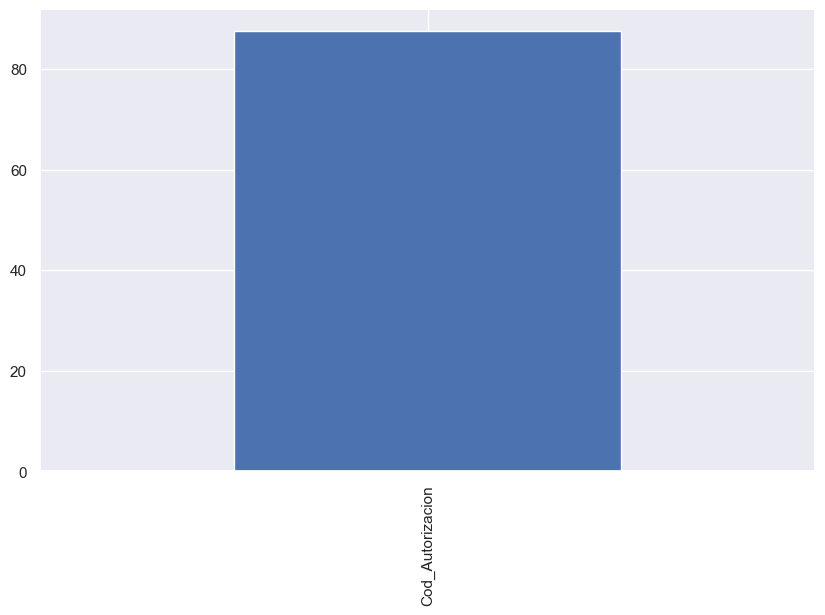

In [45]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10,6))
serie.plot(kind='bar')

<AxesSubplot:>

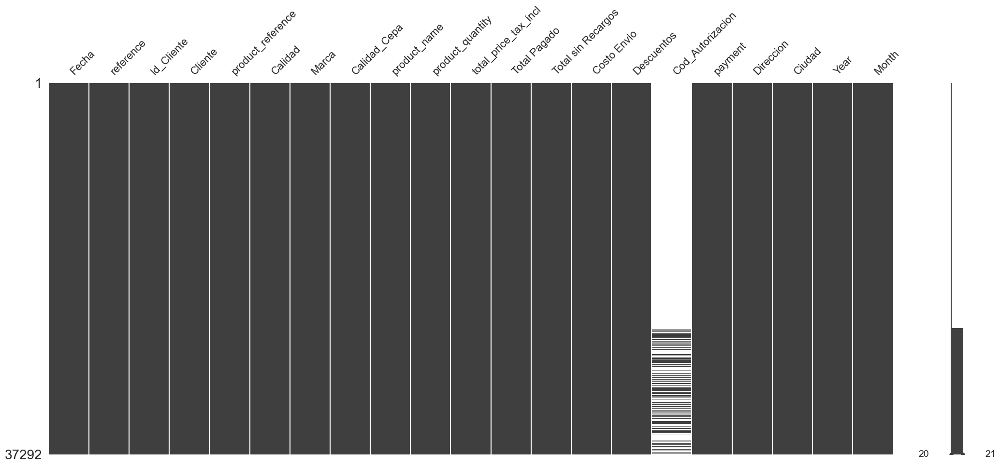

In [47]:
import missingno as msno
msno.matrix(df)

<AxesSubplot:>

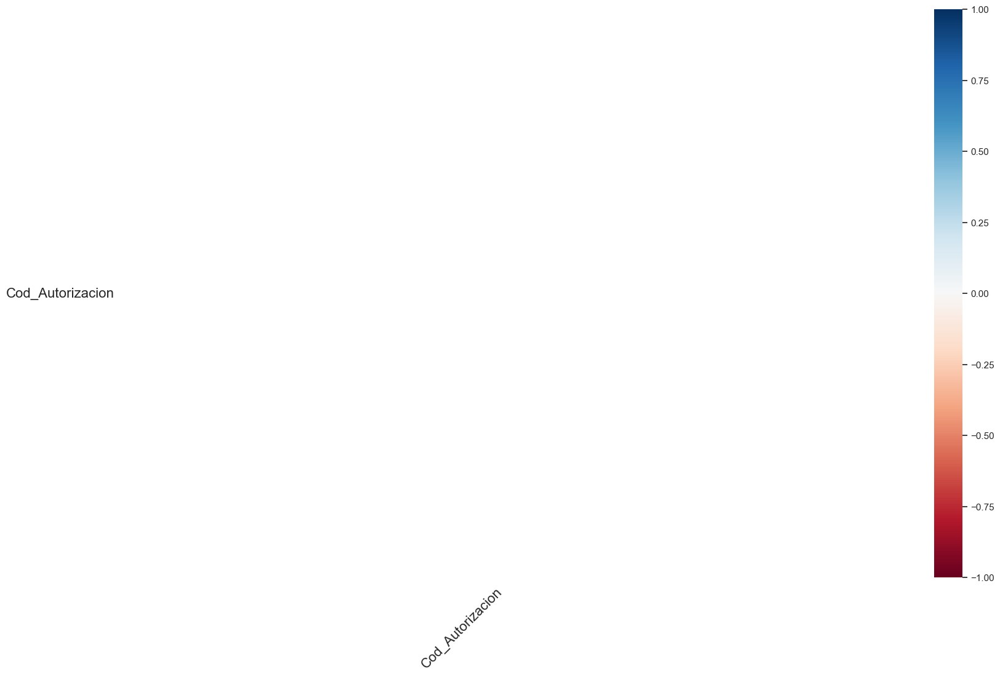

In [48]:
msno.heatmap(df)

<AxesSubplot:>

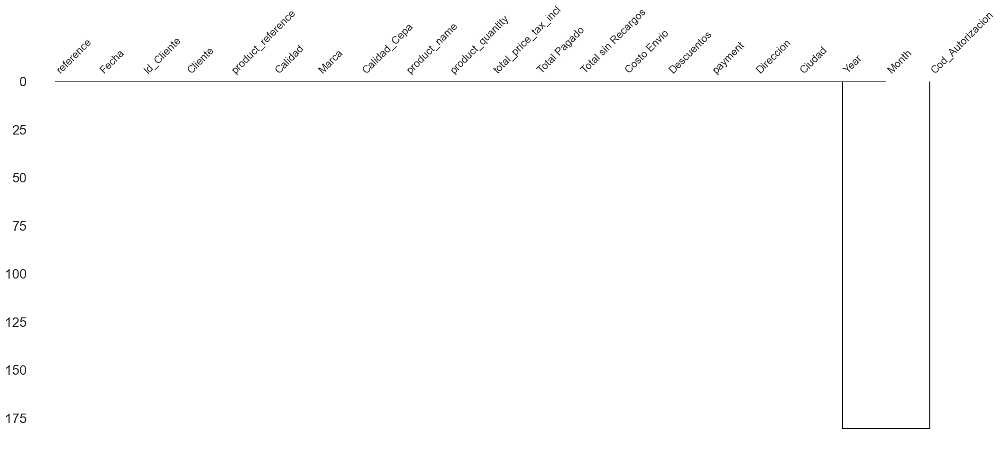

In [49]:
msno.dendrogram(df)

# Resultado de analisis

Al analisar el dataSet, se evidencia que la columna Cod_autorizacion tiene sobre un 80% de nulos, por tal razon lo excluiremos de nuestro dataSet.

# Borrado de columnas

In [50]:
col_del=['Cod_Autorizacion',] # Columnas a borrar que no aportan

df_x=df.drop(labels=col_del, axis=1)
df_x.columns

Index(['Fecha', 'reference', 'Id_Cliente', 'Cliente', 'product_reference',
       'Calidad', 'Marca', 'Calidad_Cepa', 'product_name', 'product_quantity',
       'total_price_tax_incl', 'Total Pagado', 'Total sin Recargos',
       'Costo Envio', 'Descuentos', 'payment', 'Direccion', 'Ciudad', 'Year',
       'Month'],
      dtype='object')

In [51]:
df_x.head()

,Fecha,reference,Id_Cliente,Cliente,product_reference,Calidad,Marca,Calidad_Cepa,product_name,product_quantity,total_price_tax_incl,Total Pagado,Total sin Recargos,Costo Envio,Descuentos,payment,Direccion,Ciudad,Year,Month
Orden,,,,,,,,,,,,,,,,,,,,
108,2015-02-11,EACXGFNRS,166,MARIELA VIERA,1141208,Gran Reserva,VENTISQUERO (VV),Gran Reserva Chard 750 cc,Queulat Chardonnay Bot Scrap 6x750,1,18000,72000,72000,0,0,VC WebPay,"Sector La Isla s/nÂ°, Lote A - Lo Miranda - Do...",Doñihue,2015,2
46,2015-01-09,RXLQXWRSX,6,NICOLAS MELENDEZ,1140033,Premium,VENTISQUERO (VV),Premium Merlot 750 cc,Grey Merlot Bot 6x750,1,24000,66000,66000,0,0,VC WebPay,Oficina Vertice,Rancagua,2015,1
46,2015-01-09,RXLQXWRSX,6,NICOLAS MELENDEZ,1140045,Premium,VENTISQUERO (VV),Premium Syrah 750 cc,Grey Syrah Bot 6x750,1,24000,66000,66000,0,0,VC WebPay,Oficina Vertice,Rancagua,2015,1
47,2015-02-09,MYYVJKNRV,7,EMERSSON VIDAL,1140008,Premium,VENTISQUERO (VV),Premium Cab Sauv 750 cc,Grey Cabernet Sauvignon Bot 6x750,1,24000,50000,50000,0,0,VC WebPay,"Sector La Isla s/nÂ°, Lote A - Lo Miranda - Do...",Doñihue,2015,2
47,2015-02-09,MYYVJKNRV,7,EMERSSON VIDAL,1141290,Premium,VENTISQUERO (VV),Premium Cab Sauv 750 cc,Grey Cabernet Sauvignon Caja Cuna 1x750,2,12000,50000,50000,0,0,VC WebPay,"Sector La Isla s/nÂ°, Lote A - Lo Miranda - Do...",Doñihue,2015,2


# GESTION DE INFORMACION DE E-COMMERCE

El ingreso en la forma de comercializar de los e-commerce ya es una realidad y ha ganado participación desde el año 2018. Hoy pese a su gran masividad nos encontramos con otros desafíos. Y nos saltan preguntas como:

1.- ¿Cuales son los pick de venta?

2.- ¿De dónde me estan comprando?

3.- ¿Qué productos son los mas demandado?

4.- ¿Qué sexo son los cliente que compran en el E-commerce?

In [52]:
df_calidad=df[['Year','Marca','Calidad_Cepa','product_quantity','Month']].groupby(by=['Year','Month','Marca','Calidad_Cepa']).sum().reset_index()
df_calidadx=df_calidad[['Month','Year','product_quantity']].groupby(by=['Month','Year']).sum().reset_index()
df_calidadmonth=df_calidad[['Month','Year','product_quantity']].groupby(by=['Month']).sum().reset_index()

# 1.- ¿Cuales son los pick de venta?

Estos gráficos nos muestran en que meses se genera la mayor cantidad de ventas primero con valores acumulados a lo largo de todo el horizonte temporal disponible (2015-2021) y el segundo segmentando por año.

De las graficas se obtienen dos insights interesantes referidos al objetivo numero dos ya que se observa una marcada estacionalidad en el comportamiento de los clientes.

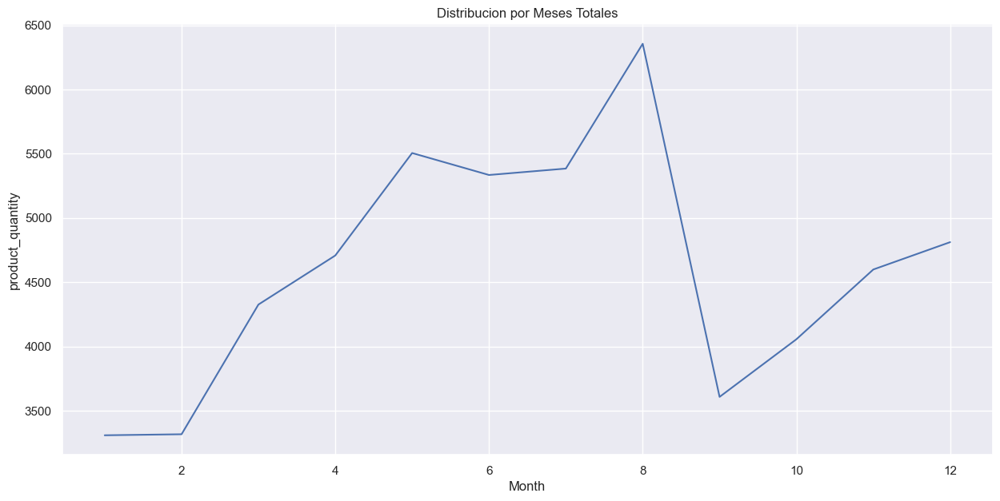

In [53]:
sns.set_theme()
fig, ax = plt.subplots(figsize=(15, 7))
sns.lineplot(x="Month", y="product_quantity", data=df_calidadmonth, markers=True, dashes=False) 
plt.title("Distribucion por Meses Totales");

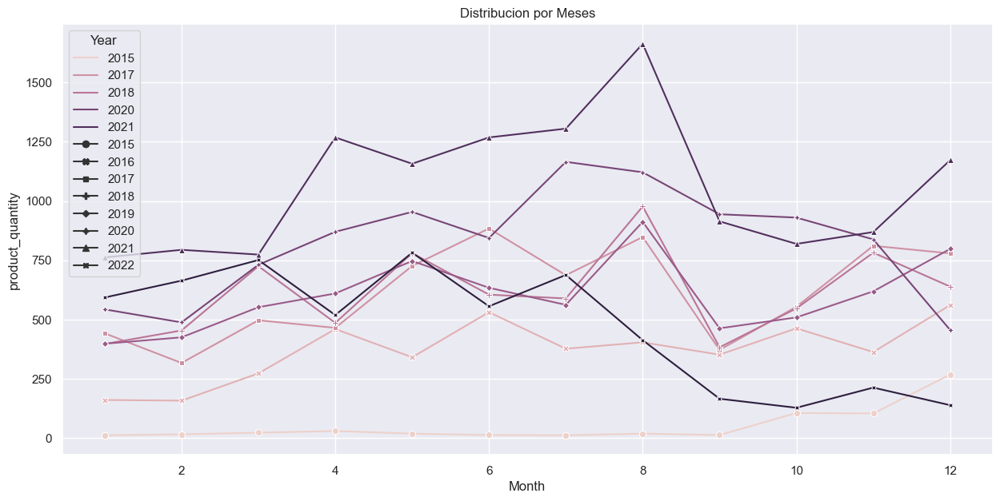

In [54]:
sns.set_theme()
fig, ax = plt.subplots(figsize=(15, 7))
sns.lineplot(x="Month", y="product_quantity", data=df_calidadx, hue="Year", style="Year",markers=True, dashes=False) 
plt.title("Distribucion por Meses");

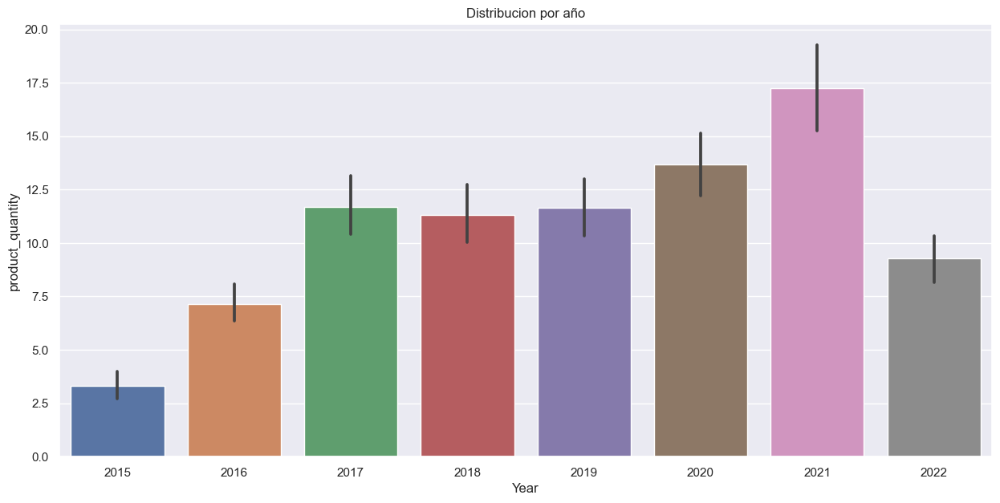

In [55]:
sns.set_theme()
fig, ax = plt.subplots(figsize=(15, 7))
sns.barplot(x="Year", y="product_quantity", data=df_calidad) 
plt.title("Distribucion por año");

# INSIGHTS DE ESTACIONALIDAD DE VENTAS

El grafico nos muestra una estacionalidad de venta muy marcada en los meses MAYO,JUNIO,JULIO y AGOSTO

# 2.- ¿De dónde me estan comprando?

Se analizan las distintas ciudades desde donde se realizan compras. Se observa una gran cantidad de diferentes puntos de compra (172 en total).


In [56]:
Ciudades=df['Ciudad'].unique()

print(Ciudades)
Ciudades.shape

['Doñihue' 'Rancagua' 'Melipilla' 'San Pedro' 'Santiago' 'Peralillo'
 'Las Cabras' 'Valparaiso' 'Con Con' 'Santiago Centro' 'Las Condes'
 'Con con' 'Lo Barnechea' 'Vitacura' 'Chicureo' 'Limache' 'Requinoa'
 'Providencia' 'La Calera' 'Colina' 'Reñaca' 'Puerto Montt' 'Ñuñoa'
 'Maipu' 'Viña Del Mar' 'Villa Alemana' 'Curacavi' 'Coyhaique'
 'Huechuraba' 'San pedro' 'La Reina' 'Machali' 'Puente Alto' 'Los Andes'
 'Paine' 'Lampa' 'San Jose de maipo' 'Concepcion' 'Peumo' 'Villarrica'
 'Temuco' 'Santago' 'Osorno' 'Coquimbo' 'San Felipe' 'La Cruz'
 'Santa Cruz' 'Coltauco' 'Pudahuel' 'Antofagasta' 'Graneros'
 'Puerto Varas' 'Talcahuano' 'El Paico' 'Curauma' 'Quinta Normal'
 'Quinta de tilcoco' 'Buin' 'Lo Miranda' 'Independencia' 'Talca'
 'El Quisco' 'Hualpencillo' 'La Florida' 'Lo Orozco' 'Los Angeles'
 'Longovilo' 'Santo Domingo' 'La Serena' 'La Pintana' 'Santaigo'
 'Estacion Central' 'Pirque' 'Quillota' 'La Cisterna' 'Ancud' 'Peñalolen'
 'Rengo' 'San Miguel' 'San Fernando' 'Peñaflor' 'Ovalle' '

(172,)

In [57]:
Ciudades=df[['Ciudad','Total Pagado']].groupby(by=['Ciudad']).count().reset_index()
Ciudades.rename(columns={'Total Pagado':'Cantidad de compras'},inplace=True)
porcantidad=Ciudades.sort_values('Cantidad de compras',ascending=False)
porcantidad.head(10)

,Ciudad,Cantidad de compras
152,Santiago,7590
121,Rancagua,5797
35,Doñihue,4379
63,Las Condes,3301
87,Melipilla,1569
166,Vitacura,1408
167,Viña Del Mar,1295
171,Ñuñoa,1048
106,Providencia,981
71,Lo Barnechea,968


# Total de ciudades

In [58]:
Ciudades['Cantidad de compras'].sum()

37292

In [59]:
total_pedidos = Ciudades['Cantidad de compras'].sum()
porcantidad['porcentajedecompras']=porcantidad['Cantidad de compras']*100/total_pedidos
top=porcantidad.head(10)
top

,Ciudad,Cantidad de compras,porcentajedecompras
152,Santiago,7590,20.352891
121,Rancagua,5797,15.544889
35,Doñihue,4379,11.742465
63,Las Condes,3301,8.851764
87,Melipilla,1569,4.207337
166,Vitacura,1408,3.775609
167,Viña Del Mar,1295,3.472595
171,Ñuñoa,1048,2.810254
106,Providencia,981,2.630591
71,Lo Barnechea,968,2.595731


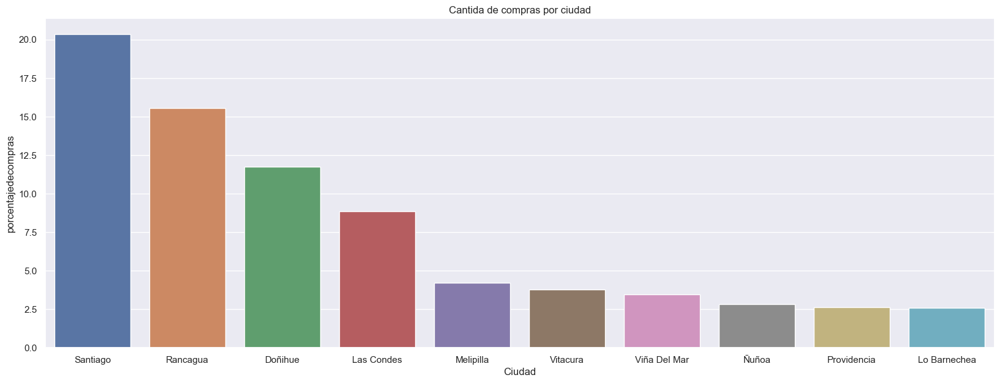

In [61]:
sns.barplot(x="Ciudad", y="porcentajedecompras",data=top ) 
sns.set( rc = {'figure.figsize':(20,25),'axes.labelsize':5})
plt.title("Cantida de compras por ciudad");

# INSIGHTS DE LUGARES DE COMPRA

Se observa que el 60% de las ventas provienen de solo cinco ciudades. Este Insight resulta muy importante para el objetivo numero 3 ya que resulta claro que la logistica en la distribucion de estas 5 ciudades es la que mayor cantidad de ventas representa.

# 3.- ¿Qué productos son los mas demandado?

Analisis de los producto con mayor demanda del dataset

In [62]:
marcas=df[['Marca','Calidad','product_quantity']].groupby(by=['Marca','Calidad']).count().reset_index()
marcas.rename(columns={'product_quantity':'Cantidad de compras'},inplace=True)
porcantidad=marcas.sort_values('Cantidad de compras',ascending=False)
porcantidad

,Marca,Calidad,Cantidad de compras
22,VENTISQUERO (VV),Premium,9762
23,VENTISQUERO (VV),Reserva,5964
21,VENTISQUERO (VV),Gran Reserva,5297
25,VENTISQUERO (VV),Super Premium,4155
16,RAMIRANA (RA),Premium,2555
15,RAMIRANA (RA),Gran Reserva,1802
17,RAMIRANA (RA),Reserva,1242
12,NOVECENTO,Reserva,1009
10,KALFU,Reserva,664
18,ROOT1 (RO),Reserva,612


In [63]:
solo_marca = df[['Marca','product_quantity','Calidad']].groupby(by=['Marca','Calidad']).count().reset_index()
solo_marca=solo_marca.sort_values('product_quantity',ascending=False)
solo_marca

,Marca,Calidad,product_quantity
22,VENTISQUERO (VV),Premium,9762
23,VENTISQUERO (VV),Reserva,5964
21,VENTISQUERO (VV),Gran Reserva,5297
25,VENTISQUERO (VV),Super Premium,4155
16,RAMIRANA (RA),Premium,2555
15,RAMIRANA (RA),Gran Reserva,1802
17,RAMIRANA (RA),Reserva,1242
12,NOVECENTO,Reserva,1009
10,KALFU,Reserva,664
18,ROOT1 (RO),Reserva,612


<AxesSubplot:xlabel='Marca', ylabel='product_quantity'>

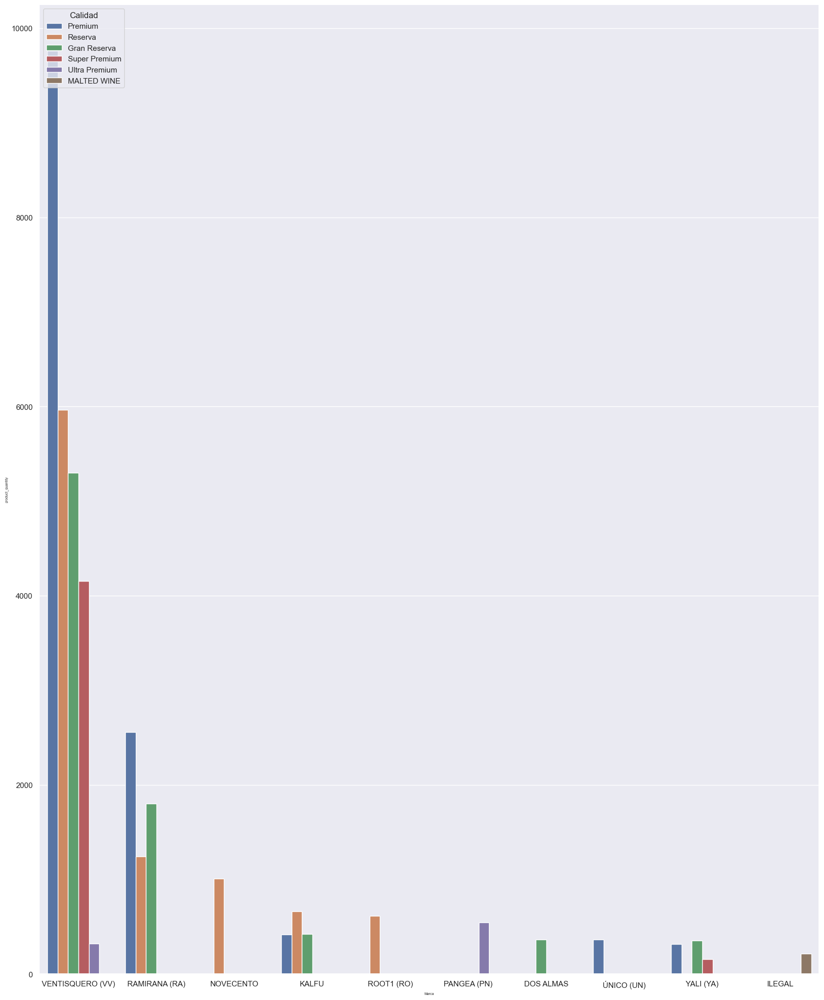

In [64]:
sns.barplot(data=solo_marca.head(20), x="Marca", y="product_quantity", hue="Calidad")

# INSIGHTS DE LUGARES DE COMPRA

Se observa que las líneas Premium y Reserva con las mayor demmandas de la marca VENTISQUERO. Esta informacion y la herramienta de modelos predictivo podremos estimar la demanda del cliente y con eso definir los stocks máximos de cada uno de las marcas y calidades. Esto ayudara muchos a mejorar la rotación de los productos y disminuir lo costos de almacenamiento y produccion.

# 4.- ¿Qué sexo son los cliente que compran en el E-commerce?

Existen en total 5227 clientes que han comprado a lo largo de todo el periodo de tiempo analizado.

In [65]:
Clientes=df["Cliente"].unique()
df["Id_Cliente"].unique().shape

(5227,)

In [66]:
import operator
import re 

def clean_text(txt):
    txt = re.sub("[^a-záéíóúñüäë]", " ", txt.lower())
    txt = re.sub(' +',' ', txt)
    return txt.strip().split()

def df_to_dict(df, key_column, val_column):
    """convierte dos pandas series en un diccionario"""
    xkey = df[key_column].tolist()
    xval = df[val_column].tolist()
    return dict(zip(xkey,xval))

def get_gender2(names):
    names = clean_text(names)
    names = [x for x in names if gender_list.get(x,'a') != 'a']
    gender ={'m':0, 'f':0, 'a':0}
    for i, name in enumerate(names):
        g = gender_list.get(name,'a')
        gender[g] += 1
        gender[g] += 2 if len(names) > 1 and i == 0 and g != 'a' else 0 
    gender['a'] = 0 if (gender['f']+gender['m']) > 0 else 1
    return max(gender.items(), key=operator.itemgetter(1))[0]

if __name__ == '__main__':
    path = 'https://www.dropbox.com/s/edm5383iffurv4x/nombres.csv?dl=1'
    gender_list = pd.read_csv(path)
    gender_list = df_to_dict(gender_list, key_column='nombre', val_column='genero')
    
    
df["genero"]=1
for i in range (0,37292):
    df.iloc[i,21]=get_gender2(df.iloc[i,3]);
    

In [67]:
df_genero=df[['Year','Marca','Calidad_Cepa','product_quantity','Month','genero','Direccion','Ciudad']].groupby(by=['genero','Year']).sum().reset_index()


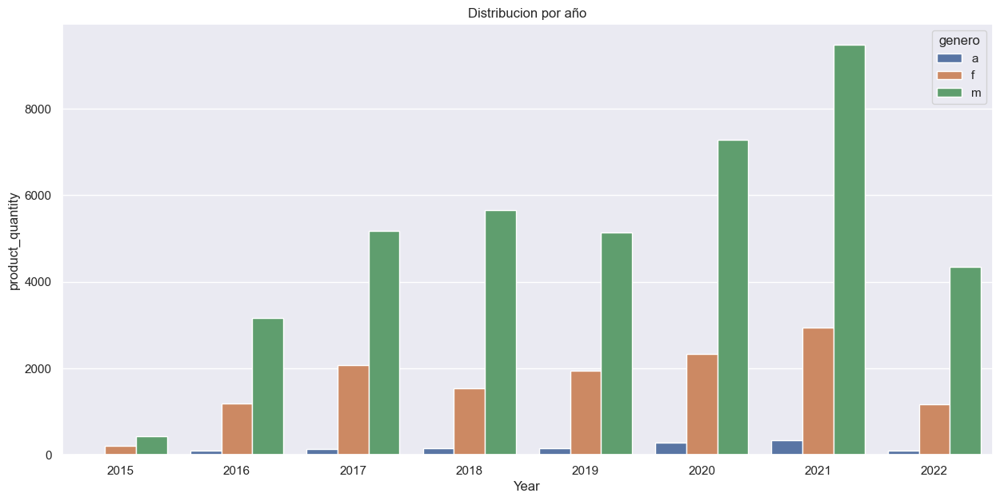

In [69]:
sns.set_theme()
fig, ax = plt.subplots(figsize=(15, 7))
sns.barplot(x="Year", y="product_quantity", data=df_genero, hue="genero") 
plt.title("Distribucion por año");

# INSIGHTS DEL GENERO DE LOS CLIENTE

Del analisis por genero se observa una marcada mayor proporción de clientes masculinos que femeninos. Sin embargo se observa que el aumento en las compras de ambos generos es proporcional.

# RESUMEN DE CONCLUSIONES

1.- ¿Cuales son los pick de venta? Este análisis de venta se percibe los pick de venta en los meses MAYO, JUNIO, JULIO y AGOSTO 

2.- ¿De dónde me estan comprando? La venta se concentra en chile central SANTIAGO, RANCAHUA, DOÑIHUE, LAS CONDES 

3.- ¿Qué productos son los mas demandado? Los productos mas demandados son de la linea VENTISQUERO en su calidad PREMIUM, RESERVA y GRAN RESERVA 

4.- ¿Qué sexo son los cliente que compran en el E-commerce? Los principales clientes son de sexo masculino pero se puede ver como desde 2018 han incrementado la compra de personas de sexo femenino.

# TEST DE MODELO DE REGRESION LINEAL PARA PREDICCION DE VENTAS

In [70]:
Ventas=df[['Marca','Calidad','product_quantity',"product_name",'Year','Month','Ciudad']].groupby(by=['Year','Month',"product_name",'Ciudad']).sum().reset_index()

In [71]:
x=Ventas[['Year','Month','Ciudad',"product_name"]]
x

,Year,Month,Ciudad,product_name
0,2015,1,Doñihue,Grey Carmenere Bot 6x750
1,2015,1,Rancagua,Grey Merlot Bot 6x750
2,2015,1,Rancagua,Grey Syrah Bot 6x750
3,2015,1,Rancagua,Queulat Carmenere Bot 6x750
4,2015,1,Doñihue,Queulat Sauvignon Blanc (Leyda) Bot ScrCap 6x750
5,2015,1,Doñihue,Root 1 Cabernet Sauvignon Bot 12x750
6,2015,1,Doñihue,Sumpai Syrah Bot ScrCap 6x750
7,2015,2,Doñihue,Grey Cabernet Sauvignon Bot 6x750
8,2015,2,Rancagua,Grey Cabernet Sauvignon Bot 6x750
9,2015,2,Doñihue,Grey Cabernet Sauvignon Caja Cuna 1x750


In [72]:
y=Ventas[["product_quantity"]]
y

,product_quantity
0,1
1,1
2,1
3,1
4,6
5,1
6,1
7,1
8,1
9,2


In [73]:
C=[2023,0.3,"Rancagua","Grey Syrah Bot 6x750"]

In [74]:
model1 = 'product_quantity~Year+Month+Ciudad+product_name'
lm1   = sm.ols(formula = model1, data = Ventas).fit()
print(lm1.summary())

                            OLS Regression Results                            
Dep. Variable:       product_quantity   R-squared:                       0.170
Model:                            OLS   Adj. R-squared:                  0.156
Method:                 Least Squares   F-statistic:                     12.57
Date:                Thu, 29 Dec 2022   Prob (F-statistic):               0.00
Time:                        23:06:09   Log-Likelihood:                -55654.
No. Observations:               21327   AIC:                         1.120e+05
Df Residuals:                   20985   BIC:                         1.147e+05
Df Model:                         341                                         
Covariance Type:            nonrobust                                         
                                                                                            coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------

In [75]:
lm1.predict({"Year": 2023,"Month": 0,"Ciudad": "Santiago","product_name": "Grey Syrah Bot 6x750"})

0    4.841065
dtype: float64

# Data Profiling

In [78]:
profile = pandas_profiling.ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]